# Visualizing Michigan Data

Will Geary

wcg2111@columbia.edu

# Load the Data

In [1]:
import pandas as pd
import numpy as np

raw_data = pd.read_csv('data/05012013.csv')
raw_data.head()

,Device,Trip,Latitude,Longitude,Speed,Heading,LocalTime
0,1026,1864523,42.25979,-83.73022,4.80,267.2375,2013-05-01 09:16:38.000
1,1026,1864523,42.25979,-83.73023,4.96,268.8500,2013-05-01 09:16:38.000
2,1026,1864523,42.25979,-83.73024,4.92,267.0875,2013-05-01 09:16:38.000
3,1026,1864523,42.25979,-83.73032,5.46,268.1375,2013-05-01 09:30:05.000
4,1026,1864523,42.25979,-83.73032,5.16,266.7375,2013-05-01 09:30:05.000


In [2]:
print len(np.unique(raw_data['Device'])), "Unique Device ID's in input dataset:"
print list(np.unique(raw_data['Device']))

36 Unique Device ID's in input dataset:
[1026, 1063, 1065, 1105, 1114, 1115, 1118, 1120, 1121, 1122, 1123, 1125, 1132, 1133, 1136, 1137, 1140, 1150, 1556, 1564, 1571, 1575, 1576, 1577, 1579, 1580, 1582, 1586, 1589, 1591, 1592, 1593, 1594, 1596, 1597, 1599]


# Map the Data

In [3]:
import folium
import palettable
%matplotlib inline

Define the color palette.

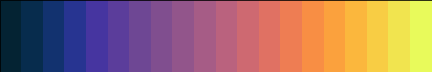

In [4]:
color_palette = palettable.cmocean.sequential.Thermal_20
color_palette.show_discrete_image()
color_palette = color_palette.colors

Some helper functions for deaing with color from: http://www.psychocodes.in/rgb-to-hex-conversion-and-hex-to-rgb-conversion-in-python.html

In [5]:
def rgb2hex(r,g,b):
    hex = "#{:02x}{:02x}{:02x}".format(r,g,b)
    return hex

def hex2rgb(hexcode):
    rgb = tuple(map(ord,hexcode[1:].decode('hex')))
    return rgb

Function to create map of trips using Folium / Leaflet.

In [17]:
def map_trips(input_df, markers=False, zoom=8, colors = color_palette * 3, skip_devices=[], filename="output.html"):
    
    df = input_df.copy()
    
    # Drop nonsensical rows
    df = df[~((df['Latitude'] == 90) & (df['Longitude'] == 180))]
    df = df[~((df['Latitude'] == 0) & (df['Longitude'] == 0))]
    
    # Drop devices in skip_devices list
    df = df[~df['Device'].isin(skip_devices)]
    
    # Mapbox basemap
    baseurl = 'http://{s}.tiles.mapbox.com/v4/mapbox.light/{z}/{x}/{y}.png'
    api_key = 'pk.eyJ1Ijoid2lsbGdlYXJ5IiwiYSI6ImNpdW9wcmkxNjAxbDUydXQ0MzFwdmdvOWkifQ.9YIdQhYTOpRpocyFK-tBNA'
    token = '?access_token={}'.format(api_key)

    # Initialize map
    my_map = folium.Map(
        location=[
            np.mean(df['Latitude']), 
            np.mean(df['Longitude'])],
        tiles = baseurl+token,
        attr='Mapbox',
        zoom_start=zoom)
    
    unique_devices = np.unique(df['Device'])
    number_of_unique_devices = len(unique_devices)
    count = 0
    
    # For every trip taken by every device...
    # Create a polyline and add it to the map
    for device_id in list(unique_devices):
        
        data = df[df['Device'] == device_id]

        for trip_id in list(np.unique(data['Trip'])):
            trip = data[data['Trip'] == trip_id]
            lats = [i for i in trip['Latitude']]
            lons = [i for i in trip['Longitude']]
            coordinates = zip(lats, lons)

            #take every 10th coordinate
            coordinates = coordinates[::10]

            my_PolyLine=folium.PolyLine(
                locations=coordinates,
                weight=4,
                color=rgb2hex(*colors[count]),
                opacity=0.8)
            my_map.add_child(my_PolyLine)

            if markers == True:
                my_marker = folium.Marker(location=[lats[0], lons[0]], popup='Device ID: {}'.format(device_id))#.add_to(map_4)
                my_map.add_child(my_marker)
            else:
                pass
        count += 1
    my_map.save(filename)
    return my_map

Here is what the raw data looks like.

In [18]:
map_trips(raw_data, zoom=7, filename="maps/raw_data.html")

Include markers to identify problematic device id's.

In [19]:
map_trips(raw_data, zoom=7, markers=True, filename="maps/raw_data_markers.html")

Drop the following device id's: 1137, 1596, 1556

In [22]:
map_trips(raw_data, zoom=10, skip_devices=[1137, 1596, 1556], filename="maps/clean_data.html")